<a href="https://colab.research.google.com/github/SamanthaHassal/time-FTS/blob/main/FTS_analysis_TIME_Copy1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#import overall libraries
import numpy as np
import matplotlib.pyplot as plt

#import custom made
import timefts.igram
import timefts.spectrum
import timefpu.utils as utils
import timefpu.coordinates as coords
import timefpu.mce_data as mce_data

In [ ]:
#import just some parts
from scipy.fftpack import dct, dst, idct, idst, fft, ifft
from scipy.ndimage.filters import gaussian_filter

In [ ]:
#I wrote these functions
def plot_over(a,b,c, plot=True):
    '''Plot values greater than the constant c'''
    B = np.where(b>c) 
    if plot:
        plt.plot(a[B], b[B])
        plt.show()
    return a[B], b[B]

def SNR(sigset, power=False, dB=False):
    '''Find approximate signal to noise ratio'''
    x = np.mean(sigset)/np.std(sigset)
    if power:
        if dB:
            return 10*np.log10(x**2)
        else:
            return x**2
    else:
        return x
    
def FWHM(freq, spec):
    '''Find the FWHM of a spectrum'''
    C = np.where(spec>=max(spec)/2)
    ooga, chaka = freq[C][0], freq[C][-1]
    return abs(ooga-chaka)

def locate_peak(x,y):
    """Find the peak frequency"""
    K = np.where(y>=np.mean(y))
    return(np.mean(x[K]))

def retrieve_index_lists(data_file):
    '''Retrieve lists of position and frequency indices'''
    #shape of data array - will need to modify for the other file
    a,b,c = data_file.shape
    #empty coordinate list
    cordsList = []
    #convert from column row to XF
    for i in range(a):
        for j in range(b):
            C = coords.muxcr_to_msbd(i, j, p=0)
            try:
                cordsList.append(list(coords.msbd_to_xf(C[0], C[1], C[2], C[3])))
            except:
                continue
    #position indices
    pos = [cord[0] for cord in cordsList]
    #freqency indices
    freq = [cord[1] for cord in cordsList]
    return pos, freq

In [ ]:
#store file name
fname = 'fts_1549775624_bias_1000'
my_file = mce_data.MCEFile(fname).Read(row_col=True, unfilter='DC').data

In [ ]:
# Pulled out from the quicklook already
short_turnarounds=[17482,130917]
num_rows = 33
row_len = 91
data_rate = 150
f_sample = 50000000 / (row_len * num_rows * data_rate)
v_mirror_mm = 2 # mm/s
cryorun = "2019-02"
det_f_list =  [24]
x_choice_list = [1,2,3,4,5,6,7,8,9,10]

#create igrams
igrams = timefts.igram.igram_snip(my_file, short_turnarounds=short_turnarounds)
coadd_igram, wlf = timefts.igram.igram_coadd(igrams, x_choice_list, outfolder=None)

[2021-03-25 11:55:28,154] INFO: Snipping asymmetric igrams...
[2021-03-25 11:55:28,793] INFO: Done snipping igrams!
[2021-03-25 11:55:29,769] INFO: Coadding timestreams...
[2021-03-25 11:55:29,774] INFO: Ejecting x01f00 (c06r26) for failing to meet peak to peak minimum
[2021-03-25 11:55:29,777] INFO: Ejecting x01f01 (c06r25) for failing to meet peak to peak minimum
[2021-03-25 11:55:29,786] INFO: Ejecting x01f07 (c07r06) for failing to meet peak to peak minimum
[2021-03-25 11:55:29,791] INFO: Ejecting x01f08 (c16r26) for failing to meet peak to peak minimum
[2021-03-25 11:55:29,795] INFO: Ejecting x01f09 (c16r25) for failing to meet peak to peak minimum
[2021-03-25 11:55:29,799] INFO: Ejecting x01f10 (c16r27) for failing to meet peak to peak minimum
[2021-03-25 11:55:29,804] INFO: Ejecting x01f11 (c16r24) for failing to meet peak to peak minimum
[2021-03-25 11:55:29,809] INFO: Ejecting x01f12 (c17r04) for failing to meet peak to peak minimum
[2021-03-25 11:55:29,814] INFO: Ejecting x01

[2021-03-25 11:55:30,829] INFO: Ejecting x01f34 (c25r09) for failing to meet peak to peak minimum
[2021-03-25 11:55:30,835] INFO: Ejecting x01f35 (c25r10) for failing to meet peak to peak minimum
[2021-03-25 11:55:30,839] INFO: Ejecting x01f36 (c13r26) for failing to meet peak to peak minimum
[2021-03-25 11:55:30,844] INFO: Ejecting x01f37 (c13r25) for failing to meet peak to peak minimum
[2021-03-25 11:55:30,848] INFO: Ejecting x01f38 (c13r27) for failing to meet peak to peak minimum
[2021-03-25 11:55:30,852] INFO: Ejecting x01f39 (c13r24) for failing to meet peak to peak minimum
[2021-03-25 11:55:30,856] INFO: Ejecting x01f40 (c15r14) for failing to meet peak to peak minimum
[2021-03-25 11:55:30,860] INFO: Ejecting x01f41 (c15r13) for failing to meet peak to peak minimum
[2021-03-25 11:55:30,865] INFO: Ejecting x01f42 (c15r15) for failing to meet peak to peak minimum
[2021-03-25 11:55:30,869] INFO: Ejecting x01f43 (c15r12) for failing to meet peak to peak minimum
[2021-03-25 11:55:30

[2021-03-25 11:55:31,439] INFO: Ejecting x02f59 (c05r18) for failing to meet peak to peak minimum
[2021-03-25 11:55:31,636] INFO: Ejecting x02f00 (c06r22) for failing to meet peak to peak minimum
[2021-03-25 11:55:31,640] INFO: Ejecting x02f01 (c06r21) for failing to meet peak to peak minimum
[2021-03-25 11:55:31,644] INFO: Ejecting x02f02 (c06r23) for failing to meet peak to peak minimum
[2021-03-25 11:55:31,649] INFO: Ejecting x02f03 (c06r20) for failing to meet peak to peak minimum
[2021-03-25 11:55:31,654] INFO: Ejecting x02f04 (c07r08) for failing to meet peak to peak minimum
[2021-03-25 11:55:31,659] INFO: Ejecting x02f05 (c07r11) for failing to meet peak to peak minimum
[2021-03-25 11:55:31,663] INFO: Ejecting x02f06 (c07r09) for failing to meet peak to peak minimum
[2021-03-25 11:55:31,668] INFO: Ejecting x02f08 (c16r22) for failing to meet peak to peak minimum
[2021-03-25 11:55:31,673] INFO: Ejecting x02f09 (c16r21) for failing to meet peak to peak minimum
[2021-03-25 11:55:31

[2021-03-25 11:55:32,205] INFO: Ejecting x03f34 (c25r25) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,209] INFO: Ejecting x03f35 (c25r26) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,212] INFO: Ejecting x03f36 (c13r18) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,216] INFO: Ejecting x03f37 (c13r17) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,220] INFO: Ejecting x03f38 (c13r19) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,224] INFO: Ejecting x03f39 (c13r16) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,228] INFO: Ejecting x03f40 (c15r30) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,231] INFO: Ejecting x03f41 (c15r29) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,234] INFO: Ejecting x03f42 (c15r31) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,238] INFO: Ejecting x03f43 (c15r28) for failing to meet peak to peak minimum
[2021-03-25 11:55:32

[2021-03-25 11:55:32,845] INFO: Ejecting x04f07 (c07r18) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,848] INFO: Ejecting x04f08 (c16r14) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,852] INFO: Ejecting x04f10 (c16r15) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,856] INFO: Ejecting x04f11 (c16r12) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,860] INFO: Ejecting x04f12 (c17r16) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,864] INFO: Ejecting x04f13 (c17r19) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,868] INFO: Ejecting x04f14 (c17r17) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,871] INFO: Ejecting x04f15 (c17r18) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,874] INFO: Ejecting x04f16 (c26r14) for failing to meet peak to peak minimum
[2021-03-25 11:55:32,882] INFO: Ejecting x04f23 (c27r18) for failing to meet peak to peak minimum
[2021-03-25 11:55:32

[2021-03-25 11:55:33,478] INFO: Ejecting x05f02 (c06r11) for failing to meet peak to peak minimum
[2021-03-25 11:55:33,481] INFO: Ejecting x05f03 (c06r08) for failing to meet peak to peak minimum
[2021-03-25 11:55:33,484] INFO: Ejecting x05f04 (c07r20) for failing to meet peak to peak minimum
[2021-03-25 11:55:33,488] INFO: Ejecting x05f05 (c07r23) for failing to meet peak to peak minimum
[2021-03-25 11:55:33,491] INFO: Ejecting x05f06 (c07r21) for failing to meet peak to peak minimum
[2021-03-25 11:55:33,495] INFO: Ejecting x05f08 (c16r10) for failing to meet peak to peak minimum
[2021-03-25 11:55:33,498] INFO: Ejecting x05f09 (c16r09) for failing to meet peak to peak minimum
[2021-03-25 11:55:33,503] INFO: Ejecting x05f12 (c17r20) for failing to meet peak to peak minimum
[2021-03-25 11:55:33,508] INFO: Ejecting x05f13 (c17r23) for failing to meet peak to peak minimum
[2021-03-25 11:55:33,511] INFO: Ejecting x05f14 (c17r21) for failing to meet peak to peak minimum
[2021-03-25 11:55:33

[2021-03-25 11:55:34,072] INFO: Ejecting x06f26 (c23r07) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,075] INFO: Ejecting x06f27 (c23r04) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,078] INFO: Ejecting x06f28 (c24r22) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,081] INFO: Ejecting x06f30 (c24r23) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,085] INFO: Ejecting x06f32 (c24r16) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,089] INFO: Ejecting x06f34 (c24r17) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,094] INFO: Ejecting x06f36 (c13r06) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,097] INFO: Ejecting x06f37 (c13r05) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,100] INFO: Ejecting x06f38 (c13r07) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,103] INFO: Ejecting x06f39 (c13r04) for failing to meet peak to peak minimum
[2021-03-25 11:55:34

[2021-03-25 11:55:34,580] INFO: Ejecting x07f13 (c17r31) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,584] INFO: Ejecting x07f14 (c17r29) for exceeding peak to peak maximum
[2021-03-25 11:55:34,587] INFO: Ejecting x07f16 (c26r02) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,590] INFO: Ejecting x07f18 (c26r03) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,593] INFO: Ejecting x07f19 (c26r00) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,597] INFO: Ejecting x07f21 (c27r31) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,600] INFO: Ejecting x07f23 (c27r30) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,602] INFO: Ejecting x07f24 (c23r02) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,607] INFO: Ejecting x07f30 (c24r31) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,613] INFO: Ejecting x07f35 (c24r26) for failing to meet peak to peak minimum
[2021-03-25 11:55:34,616] 

[2021-03-25 11:55:35,092] INFO: Ejecting x08f11 (c18r28) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,096] INFO: Ejecting x08f12 (c19r00) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,099] INFO: Ejecting x08f13 (c19r03) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,103] INFO: Ejecting x08f14 (c19r01) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,106] INFO: Ejecting x08f15 (c19r02) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,108] INFO: Ejecting x08f16 (c28r30) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,111] INFO: Ejecting x08f17 (c28r29) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,114] INFO: Ejecting x08f18 (c28r31) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,116] INFO: Ejecting x08f19 (c28r28) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,119] INFO: Ejecting x08f20 (c29r00) for failing to meet peak to peak minimum
[2021-03-25 11:55:35

[2021-03-25 11:55:35,595] INFO: Ejecting x09f09 (c18r25) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,597] INFO: Ejecting x09f10 (c18r27) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,600] INFO: Ejecting x09f11 (c18r24) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,603] INFO: Ejecting x09f12 (c19r04) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,606] INFO: Ejecting x09f13 (c19r07) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,608] INFO: Ejecting x09f14 (c19r05) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,611] INFO: Ejecting x09f15 (c19r06) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,614] INFO: Ejecting x09f16 (c28r26) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,616] INFO: Ejecting x09f17 (c28r25) for failing to meet peak to peak minimum
[2021-03-25 11:55:35,618] INFO: Ejecting x09f18 (c28r27) for failing to meet peak to peak minimum
[2021-03-25 11:55:35

[2021-03-25 11:55:36,062] INFO: Ejecting x10f09 (c18r21) for failing to meet peak to peak minimum
[2021-03-25 11:55:36,065] INFO: Ejecting x10f10 (c18r23) for failing to meet peak to peak minimum
[2021-03-25 11:55:36,067] INFO: Ejecting x10f11 (c18r20) for failing to meet peak to peak minimum
[2021-03-25 11:55:36,070] INFO: Ejecting x10f12 (c19r08) for failing to meet peak to peak minimum
[2021-03-25 11:55:36,073] INFO: Ejecting x10f13 (c19r11) for failing to meet peak to peak minimum
[2021-03-25 11:55:36,076] INFO: Ejecting x10f14 (c19r09) for failing to meet peak to peak minimum
[2021-03-25 11:55:36,078] INFO: Ejecting x10f15 (c19r10) for failing to meet peak to peak minimum
[2021-03-25 11:55:36,081] INFO: Ejecting x10f16 (c28r22) for failing to meet peak to peak minimum
[2021-03-25 11:55:36,083] INFO: Ejecting x10f17 (c28r21) for failing to meet peak to peak minimum
[2021-03-25 11:55:36,085] INFO: Ejecting x10f18 (c28r23) for failing to meet peak to peak minimum
[2021-03-25 11:55:36

In [ ]:
igrams.shape

(2, 33, 32, 53315)

In [ ]:
coadd_igram.shape

(2, 16, 53315)

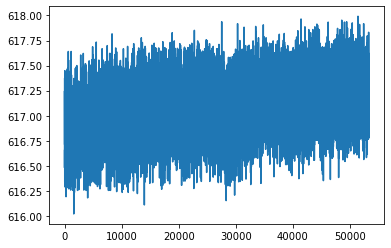

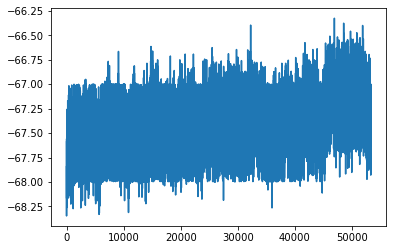

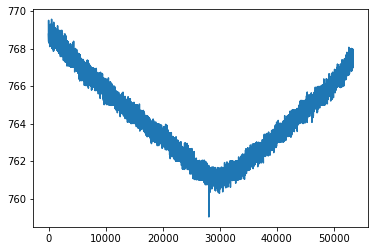

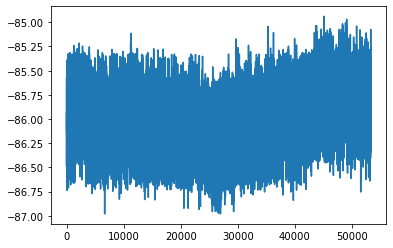

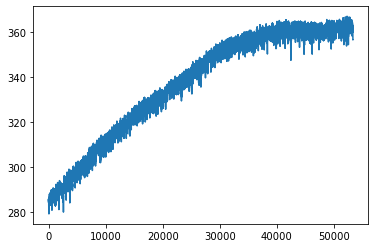

...

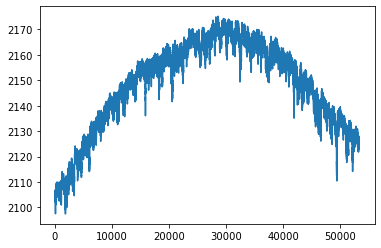

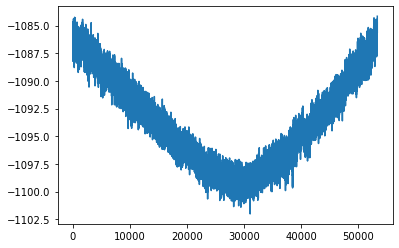

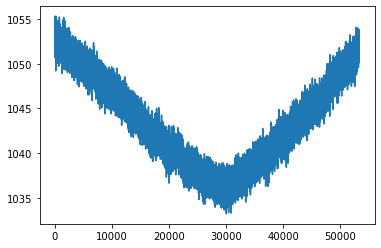

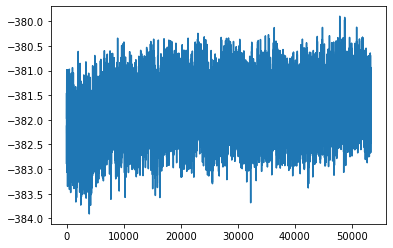

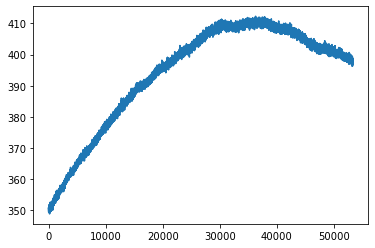

In [ ]:
#x axis for plots of interferograms
x = np.arange(igrams.shape[3])

#create dictionary of spectra
spec_dict = {}

#create dictionary of coords for nonzero igrams
non_zeroDict = {}

#fill dictionary and plot i-grams
for i in range(igrams.shape[1]):
    for j in range(igrams.shape[2]):
        if np.count_nonzero(igrams[1, i, j, :])!=0:
            #add to spectrum dictionary
            spec_dict[(i,j)] = fft(igrams[1, i,j,:])
            #add to nonzero dictionary
            try:
                non_zeroDict[(i,j)] = coords.muxcr_to_xf(i,j)
            except:
                continue
            plt.plot(x,igrams[1,i,j,:])
            plt.show()

In [ ]:
#create new dictionary of frequencies
freq_dict = {}

c_mmGHz = 299.792458 # mm * GHz

#fill dictionary 
for i in range(igrams.shape[1]):
    for j in range(igrams.shape[2]):
        if np.count_nonzero(igrams[1,i, j, :])!=0:
            spec = igrams[1,i,j,:]
            freq_dict[(i,j)] = np.fft.fftfreq(len(spec), d=1/f_sample)
            freq_dict[(i,j)] *= (c_mmGHz / (2 * v_mirror_mm))

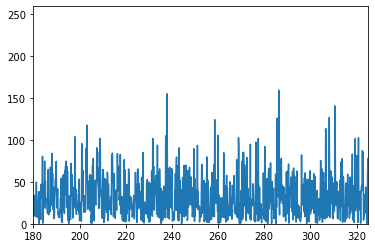

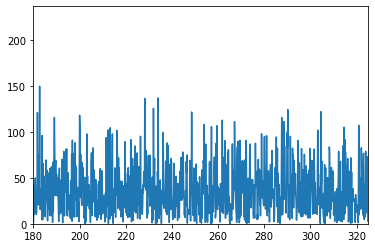

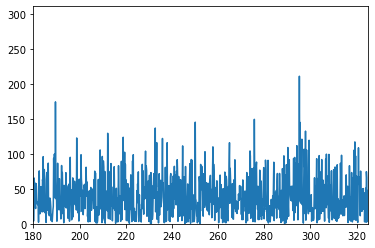

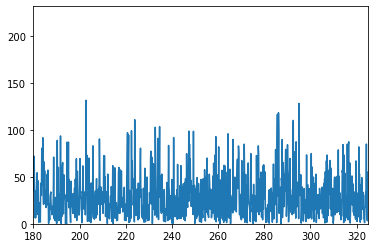

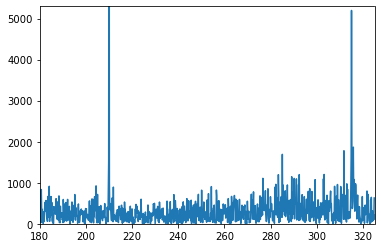

...

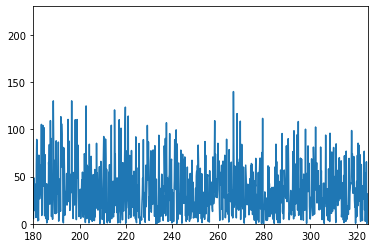

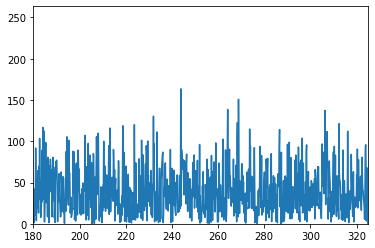

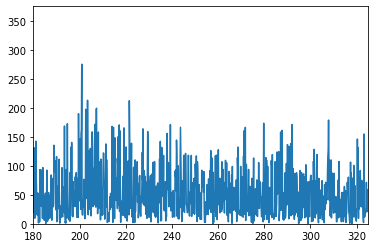

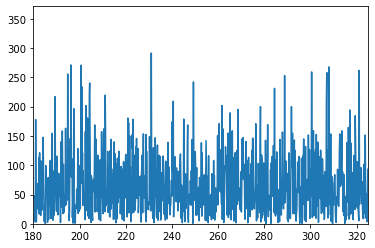

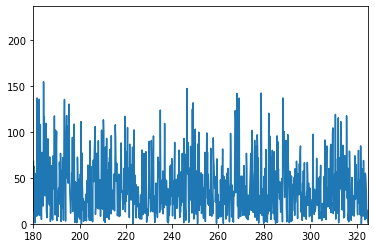

In [ ]:
for key in spec_dict.keys():
    X = np.where((freq_dict[key]<325) & (freq_dict[key]>180))
    filter_freq = freq_dict[key][X]
    filter_spec = spec_dict[key][X]
    plt.plot(filter_freq,abs(filter_spec.real))
    plt.xlim(180,325)
    plt.ylim(0, 100+max(filter_spec.real))
    plt.show()

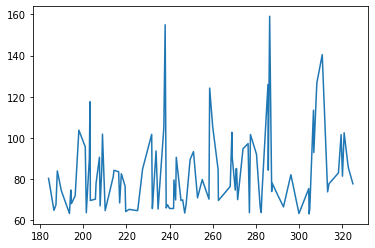

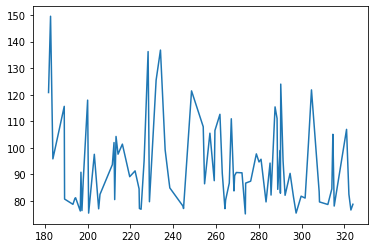

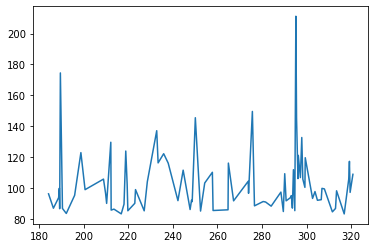

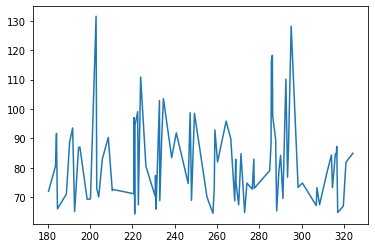

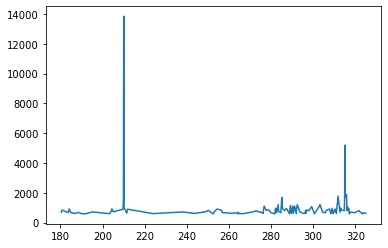

...

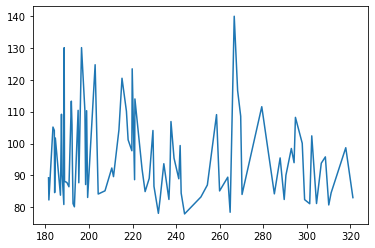

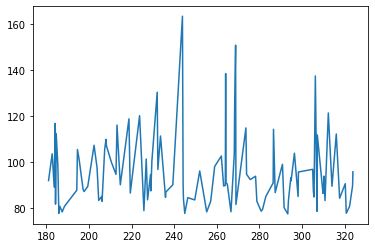

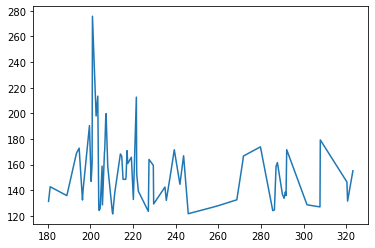

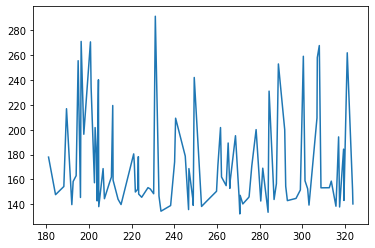

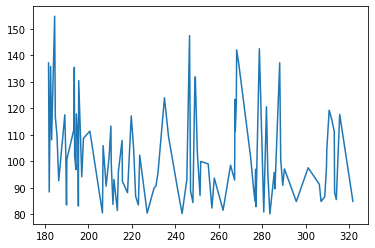

In [ ]:
#list of frequencies
frex = []
spex = []
#list of FWHM
fwhm = []
#list of maxima
peaks = []

#cutoff for the peak - 
#find the highest values in the y data
#filter out the frequencies that map to the y-values greater than 95th percentile
#this is how we define the peak

for key in spec_dict.keys():
    #filter for target frequency
    X = np.where((freq_dict[key]<325) & (freq_dict[key]>180))
    filter_freq = freq_dict[key][X]
    filter_spec = spec_dict[key][X]
    #locate the greatest data points in filter_spec
    Q = np.percentile(filter_spec, 95)
    x = filter_spec[np.where(filter_spec>Q)]
    I, J = plot_over(abs(filter_freq),abs(filter_spec.real), min(x), plot=True)
    fwhm.append(FWHM(I,J))
    frex.append(I)
    spex.append(J)
    peaks.append(locate_peak(I,J))

In [ ]:
approx_snr = [SNR(s) for s in spex]
power_snr = [SNR(s, power=True) for s in spex]
pk_over_fwhm = [peaks[i]/fwhm[i] for i in range(len(peaks)) if fwhm[i]!=0]
cords = list(spec_dict.keys())

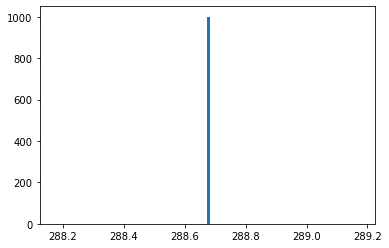

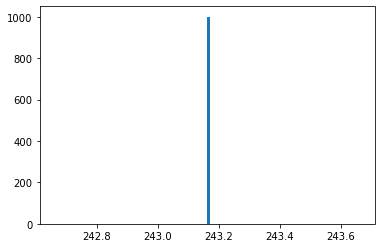

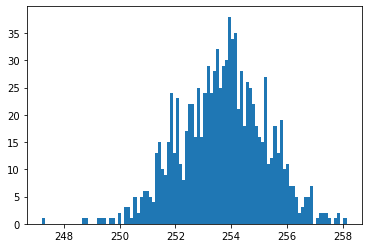

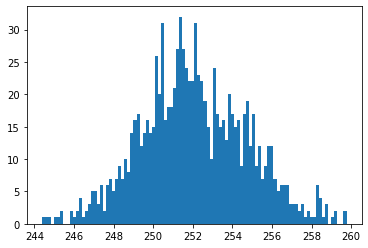

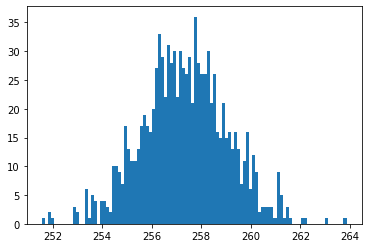

...

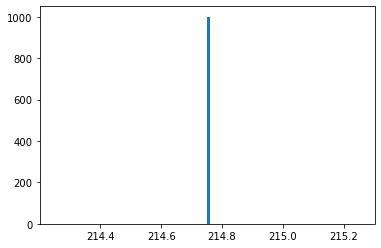

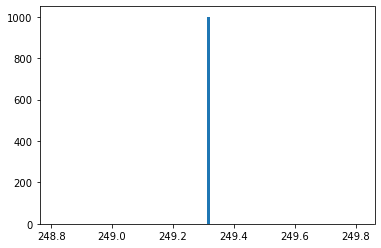

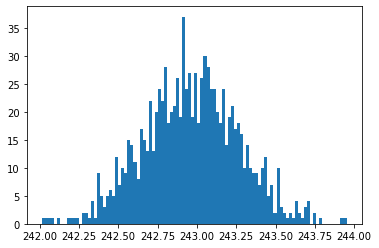

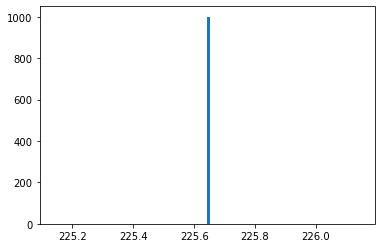

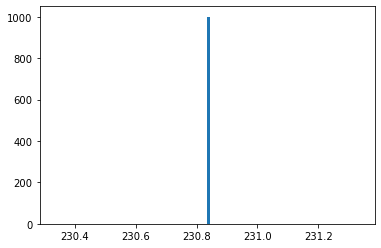

In [ ]:
#dictionary of detectors powered on
on_dict = {cords[i]:(peaks[i], fwhm[i], approx_snr[i]) for i in range(len(cords)) if fwhm[i]<4}

#list of gaussian arrays
gaussians=[np.random.normal(loc=on_dict[c][0], scale=on_dict[c][1], size=(1000)) for c in on_dict.keys()]

#plot histograms
for gauss in gaussians:
    plt.hist(gauss, bins = 100)
    plt.show()

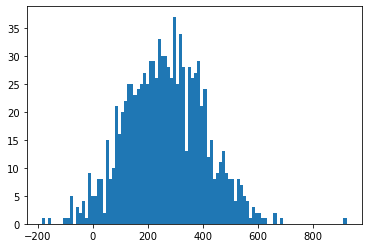

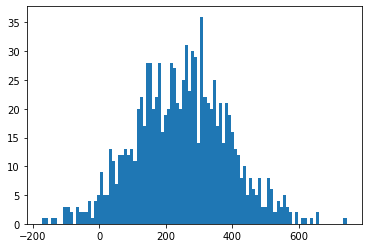

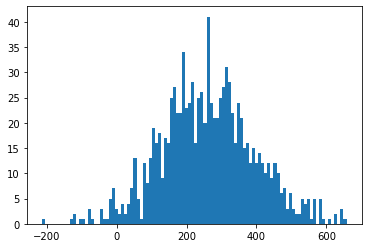

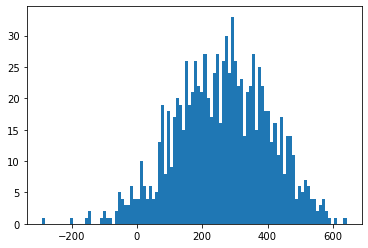

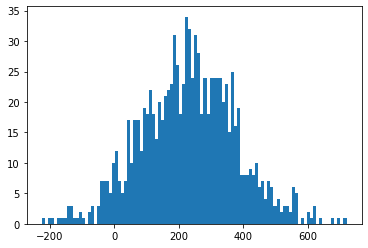

...

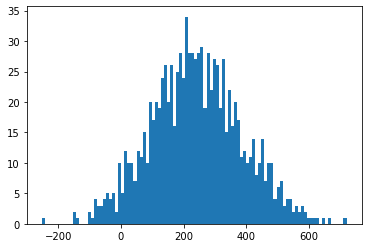

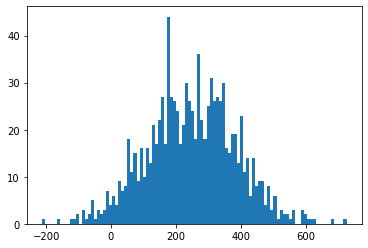

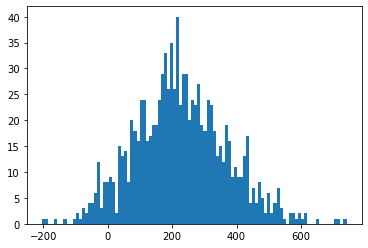

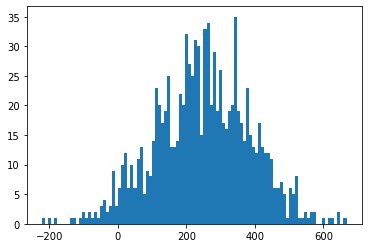

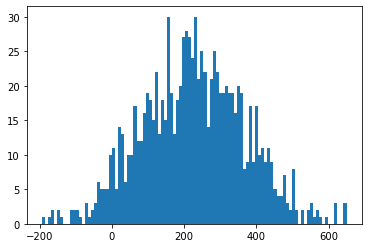

In [ ]:
#dictionary of detectors powered off
off_dict = {cords[i]:(peaks[i], fwhm[i], approx_snr[i]) for i in range(len(cords)) if fwhm[i]>=4}

#list of gaussian arrays
gaussians2=[np.random.normal(loc=off_dict[c][0], scale=off_dict[c][1], size=(1000)) for c in off_dict.keys()]

#plot histograms
for gauss in gaussians2:
    plt.hist(gauss, bins = 100)
    plt.show()

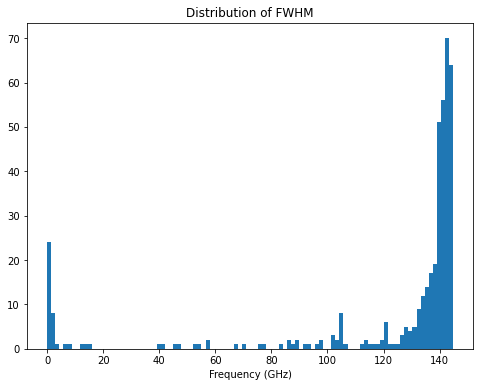

In [ ]:
#plot histogram of FWHM
plt.figure(figsize=(8,6))
plt.hist(fwhm, bins = 100)
plt.xlabel('Frequency (GHz)')
plt.title("Distribution of FWHM")
plt.savefig("fwhm_histo2.png")
plt.show()

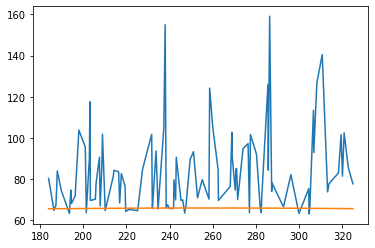

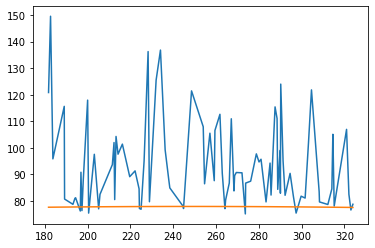

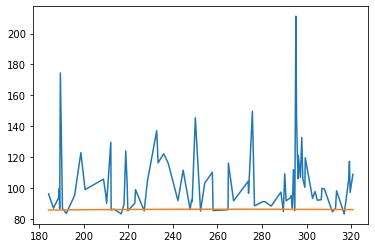

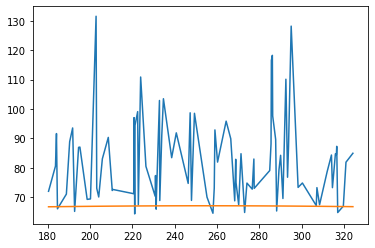

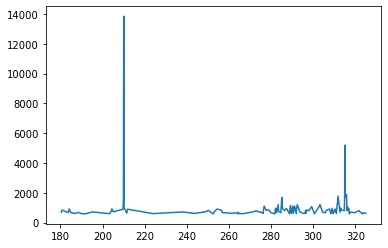

...

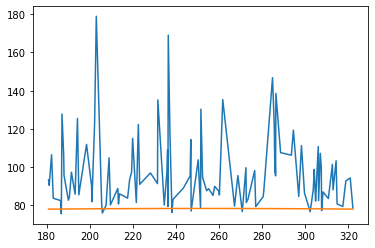

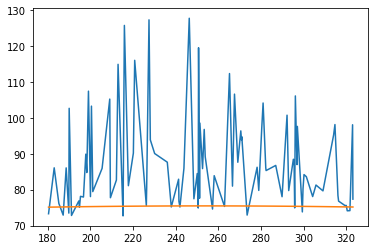

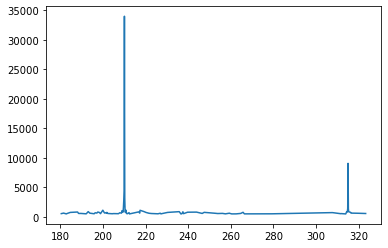

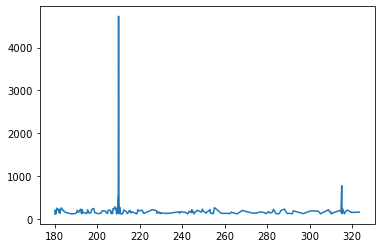

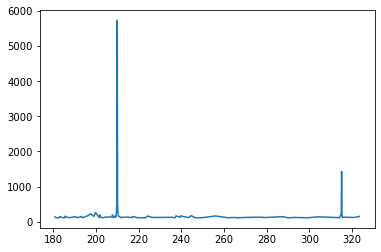

In [ ]:
# plot peaks and gaussians together
from scipy.stats import norm, spearmanr

for i in range(len(spex)):
    a, b = int(np.log10(max(spex[i]))), min(spex[i])
    plt.plot(frex[i], spex[i])
    if not fwhm[i] == 0:
        plt.plot(frex[i], 10**(a+1)*norm.pdf(frex[i], peaks[i], fwhm[i])+b)
    plt.show()

In [ ]:
len(off_dict), len(on_dict)

(388, 33)

In [ ]:
#find difference of peaks
difpeak = []
for i in range(len(spex)):
    a, b = int(np.log10(max(spex[i]))), min(spex[i])
    W = np.where(spex[i]==max(spex[i]))
    try:
        normalized = 10**(a+1)*norm.pdf(frex[i], peaks[i], fwhm[i])+b
        X = np.where(normalized==max(normalized))
        difpeak.append(np.mean(frex[i][X])-np.mean(frex[i][W]))
    except:
        difpeak.append(np.nan)

C:\Users\Sydney\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1760: RuntimeWarning: divide by zero encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
C:\Users\Sydney\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\Sydney\anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [ ]:
import pandas as pd
df = pd.DataFrame({'SNR':[approx_snr[i] for i in range(len(approx_snr)) if fwhm[i] < 4], 
                   'difference in peak': [difpeak[i] for i in range(len(approx_snr)) if fwhm[i] < 4], 
                   'power SNR':[power_snr[i] for i in range(len(approx_snr)) if fwhm[i] < 4], 
                   'FWHM':[fwhm[i] for i in range(len(approx_snr)) if fwhm[i] < 4]})
df = df.dropna()

[2021-03-25 12:16:08,510] INFO: NumExpr defaulting to 8 threads.


In [ ]:
corr, p = spearmanr(df['SNR'], df['difference in peak'])
p, p<0.05

(0.9126078919940869, False)

In [ ]:
corr, p = spearmanr(df['FWHM'], df['difference in peak'])
p, p<0.05

(0.19232842074857748, False)

In [ ]:
#plot peak differences and snr along with FWHM
fig, (ax1, ax2) = plt.subplots(2, figsize=(8,6))
fig.suptitle('Relationship between peak difference, SNR, and FWHM')
ax1.scatter(df['difference in peak'], df['SNR'], c='red')
ax1.set(ylabel='SNR')
ax2.scatter(df['difference in peak'], df['FWHM'], c='magenta')
ax2.set(xlabel='difference between normal mode and raw mode (GHz)', ylabel='FWHM (GHz)')
plt.savefig('snr_vs_fwhm2.png')
plt.show()

In [ ]:
#histogram of peak frequencies
onPeak = [on_dict[c][0] for c in on_dict.keys()]
plt.figure(figsize=(8,6))
plt.hist(onPeak, bins = 50)
plt.xlabel('Frequency (GHz)')
plt.title("Distribution of peak frequencies (raw)")
plt.savefig("peak_histo2.png")
plt.show()